**Подключение библиотек и скриптов**

In [458]:
# 1. Основные библиотеки
import numpy as np
import pandas as pd
import pickle

import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

# 2. Разделение датасета
from sklearn.model_selection import train_test_split, KFold, GridSearchCV

# 3. Модели
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor, plot_tree
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.preprocessing import StandardScaler

# 4. Метрики качества
from sklearn.metrics import mean_squared_error as mse, r2_score as r2
from sklearn.metrics import mean_absolute_error as mae

# 5. Для визуализации внешних картинок в ноутбуке
from IPython.display import Image

In [459]:
import warnings
warnings.filterwarnings('ignore')
matplotlib.rcParams.update({'font.size': 14})

**Пути к директориям и файлам**

In [460]:
DATASET_PATH = 'housing.csv'
PREPARED_DATASET_PATH = 'housing_prepared.csv'
DATASET_NEW = 'housing_new.csv'
TRAIN_DATASET = 'housing_train.csv'

REPORTS_FILE_PATH = 'reports/'
SCALER_FILE_PATH = 'scaler.pkl'
MODEL_FILE_PATH = 'model.pkl'

In [461]:
df = pd.read_csv(DATASET_NEW, sep=',')
df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,<1H OCEAN,INLAND,ISLAND,NEAR BAY,NEAR OCEAN,bedroom_share,men_per_household,population_per_room,age_cat,city
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,0,0,0,1,0,14.659091,2.555556,0.365909,4,1
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,0,0,0,1,0,15.579659,2.109842,0.338217,3,1
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,0,0,0,1,0,12.951602,2.802260,0.338105,4,1
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,0,0,0,1,0,18.445839,2.547945,0.437991,4,1
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,0,0,0,1,0,17.209589,2.181467,0.347265,4,1


In [462]:
def reduce_mem_usage(df):
    """ iterate through all the columns of a dataframe and modify the data type
        to reduce memory usage.
    """
    start_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage of dataframe is {:.2f} MB'.format(start_mem))

    for col in df.columns:
        col_type = df[col].dtype

        if col_type != object:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)
            else:
                if c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)
        else:
            df[col] = df[col].astype('category')

    end_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage after optimization is: {:.2f} MB'.format(end_mem))
    print('Decreased by {:.1f}%'.format(100 * (start_mem - end_mem) / start_mem))

    return df

In [463]:
df = reduce_mem_usage(df)

Memory usage of dataframe is 2.85 MB
Memory usage after optimization is: 1.03 MB
Decreased by 63.8%


In [464]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19641 entries, 0 to 19640
Data columns (total 19 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   longitude            19641 non-null  float32
 1   latitude             19641 non-null  float32
 2   housing_median_age   19641 non-null  float32
 3   total_rooms          19641 non-null  float32
 4   total_bedrooms       19641 non-null  float32
 5   population           19641 non-null  float32
 6   households           19641 non-null  float32
 7   median_income        19641 non-null  float32
 8   median_house_value   19641 non-null  float32
 9   <1H OCEAN            19641 non-null  int8   
 10  INLAND               19641 non-null  int8   
 11  ISLAND               19641 non-null  int8   
 12  NEAR BAY             19641 non-null  int8   
 13  NEAR OCEAN           19641 non-null  int8   
 14  bedroom_share        19641 non-null  float32
 15  men_per_household    19641 non-null 

In [465]:
def evaluate_preds(true_values, pred_values, save=False):
    """Оценка качества модели и график preds vs true"""

    print("R2:\t" + str(round(r2(true_values, pred_values), 3)) + "\n" +
          "MAE:\t" + str(round(mae(true_values, pred_values), 3)) + "\n" +
          "MSE:\t" + str(round(mse(true_values, pred_values), 3)) + "\n" +
          "RMSE:\t" + str(round(np.sqrt(mse(true_values, pred_values)), 3))
         )

    plt.figure(figsize=(8,8))

    sns.scatterplot(x=pred_values, y=true_values)
    plt.plot([0, 500000], [0, 500000], linestyle='--', color='black')  # диагональ, где true_values = pred_values

    plt.xlabel('Predicted values')
    plt.ylabel('True values')
    plt.title('True vs Predicted values')

    if save == True:
        plt.savefig(REPORTS_FILE_PATH + 'report.png')
    plt.show()

**Создание матрицы признаков**

In [466]:
feature_names = df.columns.tolist()
feature_names.remove('median_house_value')

target_name = 'median_house_value'

После предварительного обучения и тестирования модели выяснил, что следующие признаки практически не влияют на результат: их "важность" 0.01 и меньше. Поэтому из итогового датасета эти признаки удаляю.

P.S. Признаки "total_rooms" и "total_bedrooms" практически коллинеарны, а признаки "population" и "households" использованы в расчётных признаках "population_per_room" и "men_per_household", вследствие чего их важность очень незначительна.

In [ ]:
feature_names.remove('bedroom_share')
feature_names.remove('total_rooms')
feature_names.remove('total_bedrooms')
feature_names.remove('population')
feature_names.remove('households')
feature_names.remove('NEAR OCEAN')
feature_names.remove('<1H OCEAN')
feature_names.remove('NEAR BAY')
feature_names.remove('age_cat')
feature_names.remove('ISLAND')
feature_names.remove('city')

In [467]:
feature_names

['longitude',
 'latitude',
 'housing_median_age',
 'median_income',
 'INLAND',
 'men_per_household',
 'population_per_room']

**Стандартизация признаков**

In [468]:
feature_names_for_stand = df[feature_names].select_dtypes(include=['float32']).columns.tolist()
feature_names_for_stand

['longitude',
 'latitude',
 'housing_median_age',
 'median_income',
 'men_per_household',
 'population_per_room']

In [469]:
scaler = StandardScaler()
stand_features = scaler.fit_transform(df[feature_names_for_stand])

При построении различных графиков на этапе предварительного анализа было видно, что географически вся недвижимость располагается в двух больших районах. Для разделения на районы был добавлен признак "city".

Для проверки гипотезы о том, что модели для каждого района будут работать эффективнее, чем общая, далее буду использовать три датасета и три модели:
1. df - "общий" датасет, df1 и df2 - датасеты для районов.
2. Все модели без индекса - "общие", с индексами 1 и 2 - для районов по отдельности.

In [470]:
df[feature_names_for_stand] = pd.DataFrame(stand_features, columns=feature_names_for_stand)
df1 = df.loc[df['city'] == 0]
df2 = df.loc[df['city'] == 1]

Сохранение общего датасета.

In [508]:
df.to_csv(TRAIN_DATASET, index=False, encoding='utf-8', sep=',')

**Разбиение на train / test**

In [509]:
X = df[feature_names]
y = df[target_name]

X1 = df1[feature_names]
y1 = df1[target_name]

X2 = df2[feature_names]
y2 = df2[target_name]


In [526]:
X.head()

,longitude,latitude,housing_median_age,median_income,INLAND,men_per_household,population_per_room
0,-1.329918,1.037149,1.024966,2.961119,0,-0.502333,-0.921657
1,-1.324931,1.027844,-0.604305,2.945956,0,-1.093738,-1.033853
2,-1.334900,1.023191,1.921064,2.280832,0,-0.174987,-1.034305
3,-1.339886,1.023191,1.921064,1.252373,0,-0.512430,-0.629620
4,-1.339886,1.023191,1.921064,0.107581,0,-0.998700,-0.997194


In [527]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.33, shuffle = True, random_state = 21)

X1_train, X1_test, y1_train, y1_test = train_test_split(X1, y1, test_size = 0.33, shuffle = True, random_state = 21)

X2_train, X2_test, y2_train, y2_test = train_test_split(X2, y2, test_size = 0.33, shuffle = True, random_state = 21)

Начнём построение модели с линейной регрессии. Именно эта модель будет "отправной точкой", с которой я дальше буду сравнивать другие модели.

**Линейная регрессия**

In [528]:
lr_model = LinearRegression()
lr_model.fit(X_train, y_train)

lr_model1 = LinearRegression()
lr_model1.fit(X1_train, y1_train)

lr_model2 = LinearRegression()
lr_model2.fit(X2_train, y2_train)

LinearRegression()

R2:	0.624
MAE:	43911.85
MSE:	3571690000.0
RMSE:	59763.617


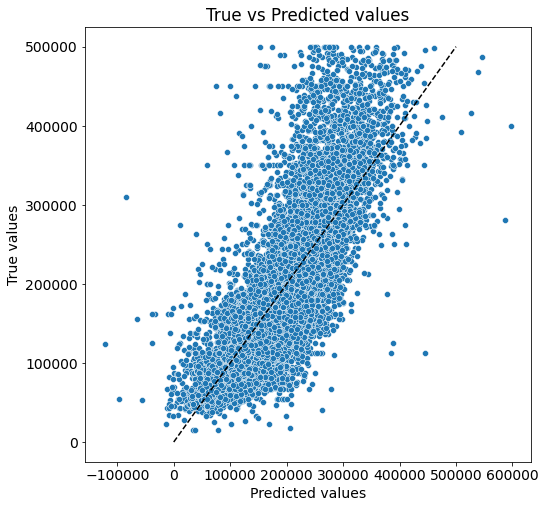

R2:	0.605
MAE:	43762.93
MSE:	3570863600.0
RMSE:	59756.703


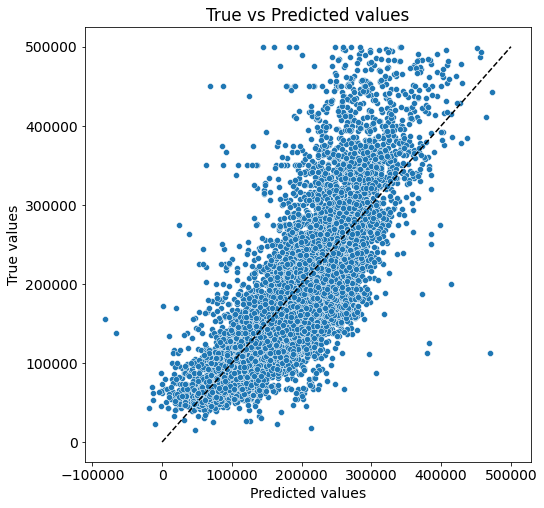

R2:	0.674
MAE:	43553.61
MSE:	3388498000.0
RMSE:	58210.805


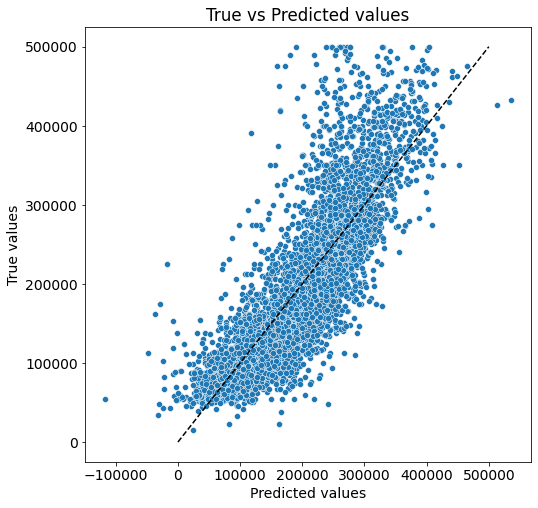

In [529]:
y_train_preds = lr_model.predict(X_train)
evaluate_preds(y_train, y_train_preds)

y1_train_preds = lr_model1.predict(X1_train)
evaluate_preds(y1_train, y1_train_preds)

y2_train_preds = lr_model2.predict(X2_train)
evaluate_preds(y2_train, y2_train_preds)

R2:	0.626
MAE:	44157.68
MSE:	3614374400.0
RMSE:	60119.668


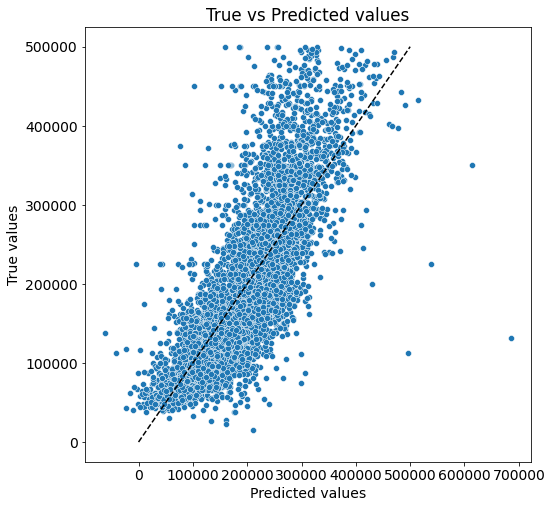

R2:	0.617
MAE:	43749.008
MSE:	3505337000.0
RMSE:	59205.887


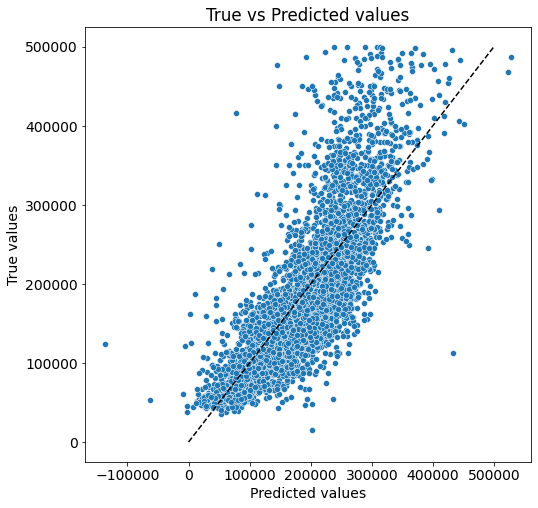

R2:	0.611
MAE:	45696.23
MSE:	3962596400.0
RMSE:	62949.156


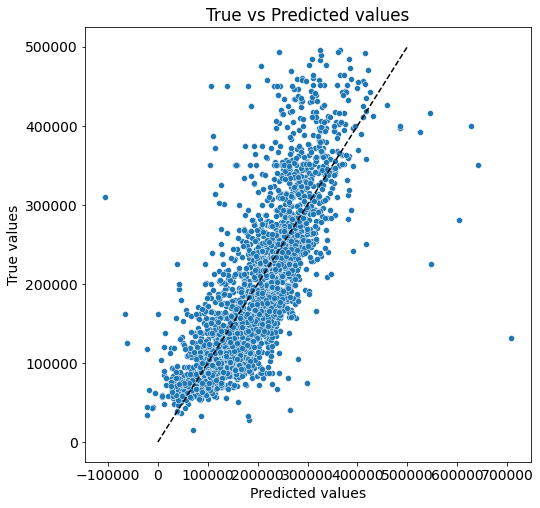

In [530]:
y_test_preds = lr_model.predict(X_test)
evaluate_preds(y_test, y_test_preds)

y1_test_preds = lr_model1.predict(X1_test)
evaluate_preds(y1_test, y1_test_preds)

y2_test_preds = lr_model2.predict(X2_test)
evaluate_preds(y2_test, y2_test_preds)

Можно сделать следующие выводы:
1. Модели линейной регрессии не слишком точны, зато обучаются очень быстро. И могут быть использованы для сравнения с другими моделями.
2. Результаты моделей на тренировочных и тестовых датасетах близки между собой, поэтому можно говорить о том, что на этапе тренировки модель не переобучилась.
3. Одна общая модель имеет чуть лучшие результаты, чем модели для каждого из районов города в отдельности. Но это пока предварительный вывод.

**Random Forest**

In [531]:
rf_model = RandomForestRegressor(criterion = 'mse',
                                 max_depth = 10,
                                 random_state = 21,
                                 n_estimators = 100
                                 )
rf_model.fit(X_train, y_train)

rf_model1 = RandomForestRegressor(criterion = 'mse',
                                 max_depth = 10,
                                 random_state = 21,
                                 n_estimators = 100
                                 )
rf_model1.fit(X1_train, y1_train)

rf_model2 = RandomForestRegressor(criterion = 'mse',
                                 max_depth = 10,
                                 random_state = 21,
                                 n_estimators = 100
                                 )
rf_model2.fit(X2_train, y2_train)

RandomForestRegressor(max_depth=10, random_state=21)

R2:	0.852
MAE:	26348.817
MSE:	1401205600.988
RMSE:	37432.681


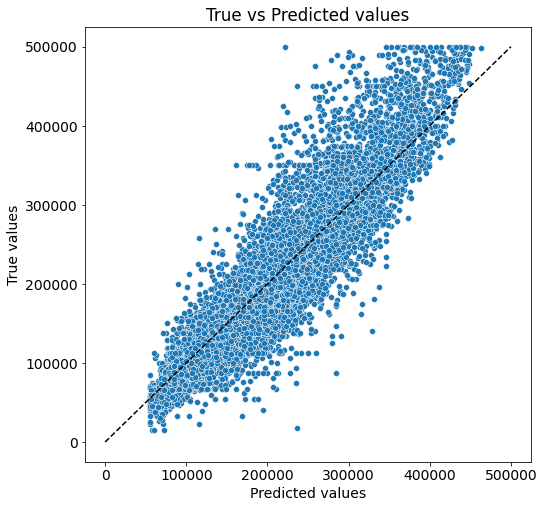

R2:	0.89
MAE:	21742.364
MSE:	997565843.86
RMSE:	31584.266


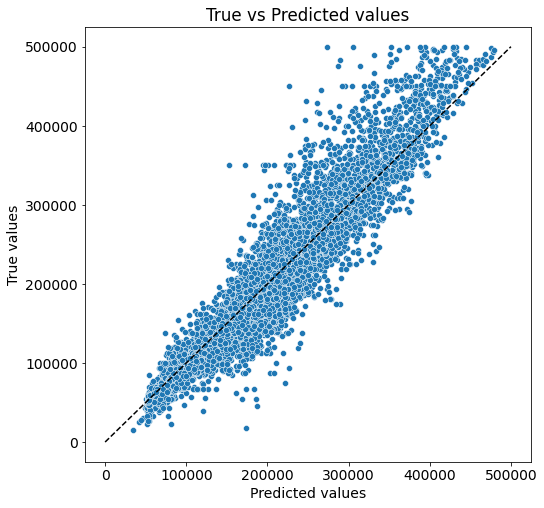

R2:	0.924
MAE:	20163.423
MSE:	791166778.547
RMSE:	28127.687


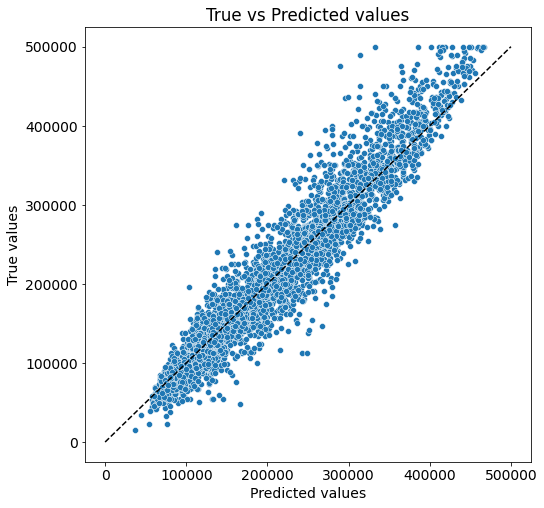

In [532]:
y_train_preds = rf_model.predict(X_train)
evaluate_preds(y_train, y_train_preds)

y1_train_preds = rf_model1.predict(X1_train)
evaluate_preds(y1_train, y1_train_preds)

y2_train_preds = rf_model2.predict(X2_train)
evaluate_preds(y2_train, y2_train_preds)

R2:	0.764
MAE:	32701.036
MSE:	2277183494.48
RMSE:	47719.844


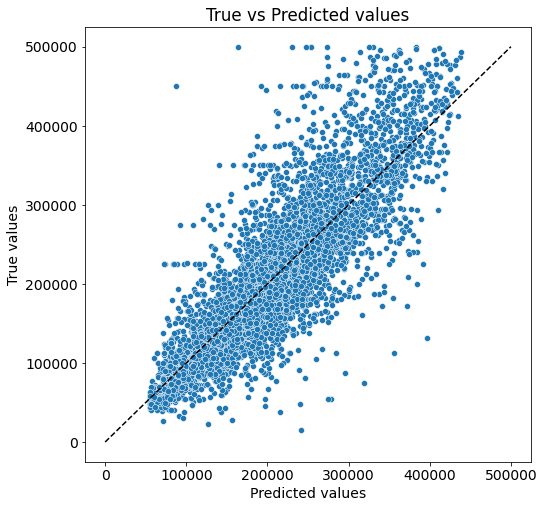

R2:	0.792
MAE:	28856.817
MSE:	1907666938.76
RMSE:	43676.847


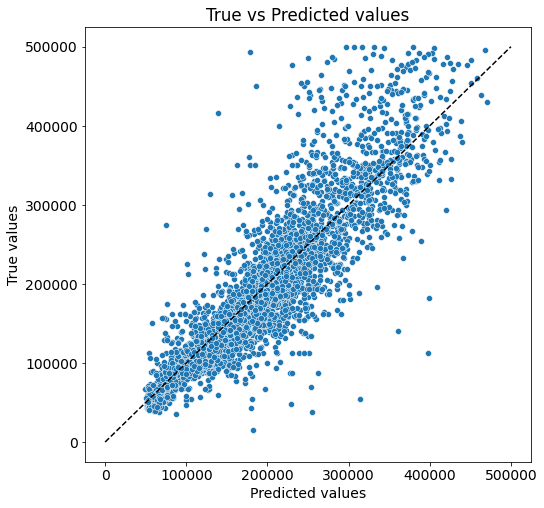

R2:	0.785
MAE:	31342.607
MSE:	2188819226.68
RMSE:	46784.818


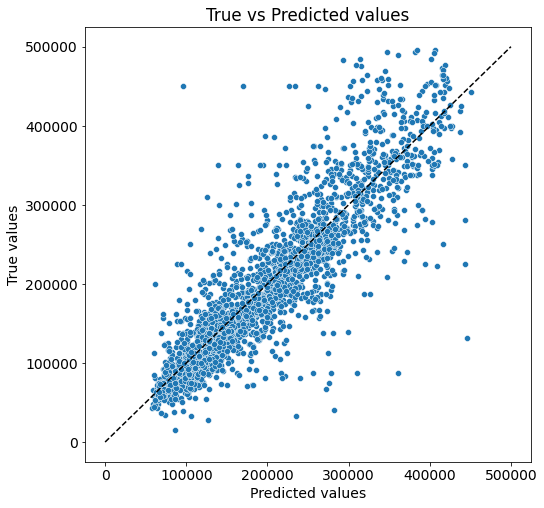

In [533]:
y_test_preds = rf_model.predict(X_test)
evaluate_preds(y_test, y_test_preds)

y1_test_preds = rf_model1.predict(X1_test)
evaluate_preds(y1_test, y1_test_preds)

y2_test_preds = rf_model2.predict(X2_test)
evaluate_preds(y2_test, y2_test_preds)

Выводы:
1. "Случайный лес" - более эффективная модель по сравнению с линейной регрессией.
2. Сам по себе данный алгоритм склонен к переобучению, что мы и можем увидеть выше: на тестовом датасете r2 примерно на 0.1 ниже, чем на тренировочном. Ошибки MAE и MSE также выше на тестовом датасете.
3. Модели для районов в отдельности работают лучше, чем общая модель: r2 на 0.02-0.03 больше, MAE и MSE меньше.

**Gradient Boosting**

In [534]:
gb_model = GradientBoostingRegressor(criterion = 'mse',
                          min_samples_leaf = 6,
                          random_state = 21
                          )
gb_model.fit(X_train, y_train)

gb_model1 = GradientBoostingRegressor(criterion = 'mse',
                          min_samples_leaf = 6,
                          random_state = 21
                          )
gb_model1.fit(X1_train, y1_train)

gb_model2 = GradientBoostingRegressor(criterion = 'mse',
                          min_samples_leaf = 6,
                          random_state = 21
                          )
gb_model2.fit(X2_train, y2_train)

GradientBoostingRegressor(criterion='mse', min_samples_leaf=6, random_state=21)

R2:	0.769
MAE:	33124.949
MSE:	2194902261.37
RMSE:	46849.784


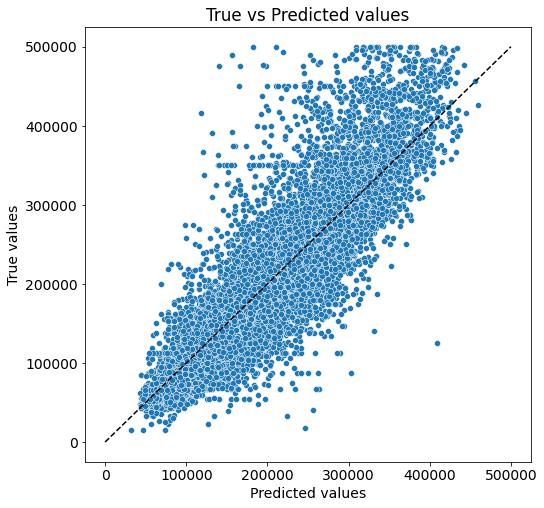

R2:	0.792
MAE:	29915.105
MSE:	1877285008.972
RMSE:	43327.647


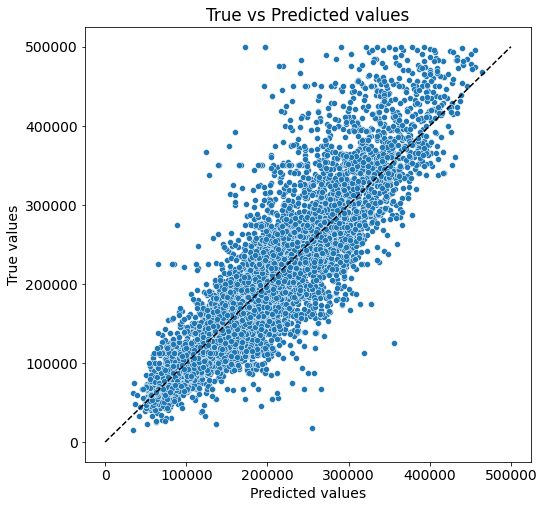

R2:	0.835
MAE:	29111.315
MSE:	1711570403.172
RMSE:	41371.13


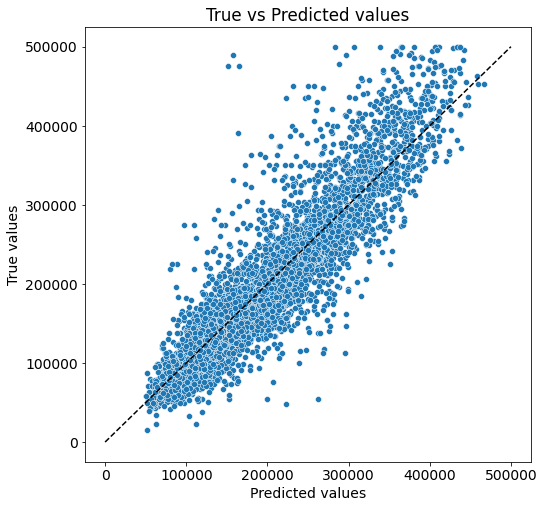

In [535]:
y_train_preds = gb_model.predict(X_train)
evaluate_preds(y_train, y_train_preds)

y1_train_preds = gb_model1.predict(X1_train)
evaluate_preds(y1_train, y1_train_preds)

y2_train_preds = gb_model2.predict(X2_train)
evaluate_preds(y2_train, y2_train_preds)

R2:	0.754
MAE:	34215.774
MSE:	2380772912.981
RMSE:	48793.165


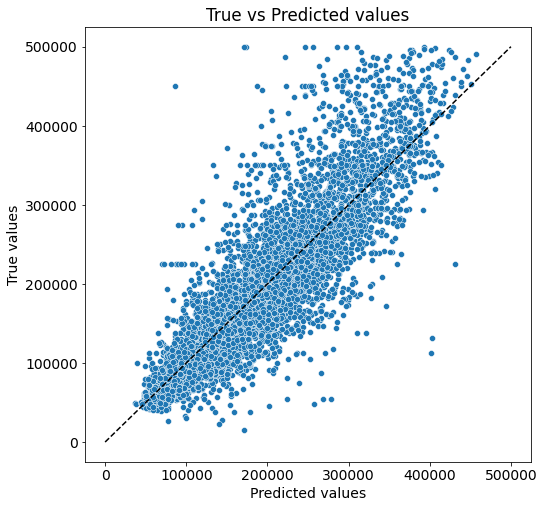

R2:	0.773
MAE:	31079.288
MSE:	2077451481.021
RMSE:	45579.068


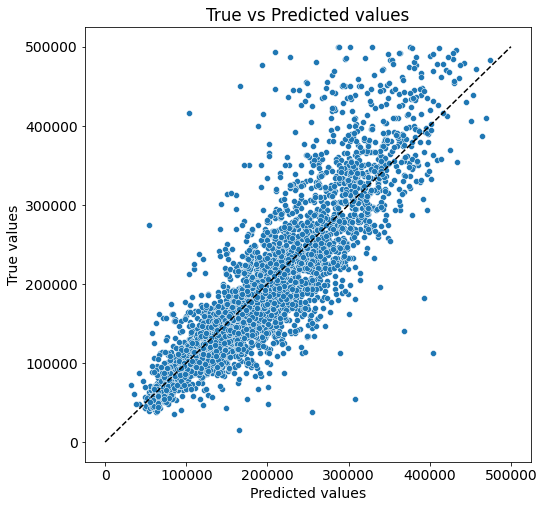

R2:	0.777
MAE:	32516.49
MSE:	2275255967.796
RMSE:	47699.643


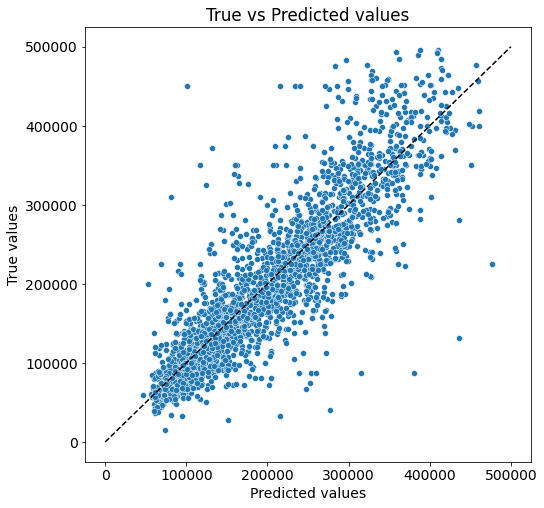

In [536]:
y_test_preds = gb_model.predict(X_test)
evaluate_preds(y_test, y_test_preds)

y1_test_preds = gb_model1.predict(X1_test)
evaluate_preds(y1_test, y1_test_preds)

y2_test_preds = gb_model2.predict(X2_test)
evaluate_preds(y2_test, y2_test_preds)

Выводы:
1. Модели с использованием градиентного бустинга не переобучены, т.к. результаты на тренировочном и тестовом датасетах близки.
2. Модели для отдельных районов совсем на немного лучше общей модели.

## **Настройка и оценка финальной модели**

**Подбор гиперпараметров**

In [543]:
params = {'n_estimators': [50, 100, 200, 400],
          'max_depth': [3, 5, 7, 10],
          'min_samples_leaf': [4, 6, 8, 10]
          }

gs = GridSearchCV(gb_model, params,
                  scoring = 'r2',
                  cv = KFold(n_splits = 3,   # k (кол-во разбиений/итераций) в кросс-валидации
                             random_state = 21,
                             shuffle = True),
                  n_jobs = -1
                 )
gs.fit(X_train, y_train)

GridSearchCV(cv=KFold(n_splits=3, random_state=21, shuffle=True),
             estimator=GradientBoostingRegressor(criterion='mse',
                                                 min_samples_leaf=6,
                                                 random_state=21),
             n_jobs=-1,
             param_grid={'max_depth': [3, 5, 7, 10],
                         'min_samples_leaf': [4, 6, 8, 10],
                         'n_estimators': [50, 100, 200, 400]},
             scoring='r2')

In [544]:
gs.best_params_

{'max_depth': 5, 'min_samples_leaf': 8, 'n_estimators': 400}

**Обучение и оценка модели**

In [553]:
final_model = GradientBoostingRegressor(n_estimators = 400, max_depth = 5, min_samples_leaf = 8, random_state = 21)
final_model.fit(X_train, y_train)

final_model1 = GradientBoostingRegressor(n_estimators = 400, max_depth = 5, min_samples_leaf = 8, random_state = 21)
final_model1.fit(X1_train, y1_train)

final_model2 = GradientBoostingRegressor(n_estimators = 400, max_depth = 5, min_samples_leaf = 8, random_state = 21)
final_model2.fit(X2_train, y2_train)

GradientBoostingRegressor(max_depth=5, min_samples_leaf=8, n_estimators=400,
                          random_state=21)

R2:	0.902
MAE:	20856.029
MSE:	925640499.608
RMSE:	30424.341


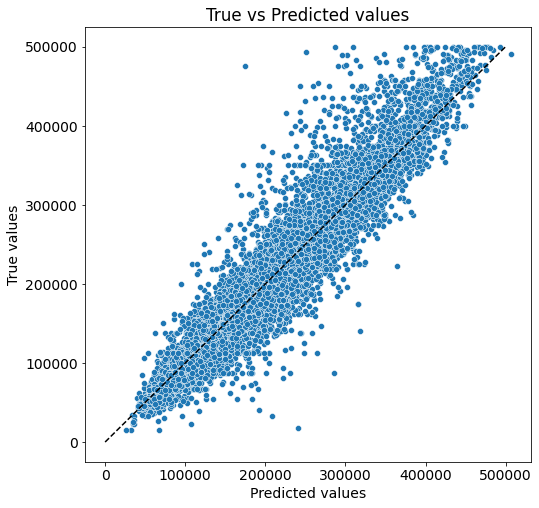

R2:	0.924
MAE:	18031.596
MSE:	689876619.067
RMSE:	26265.502


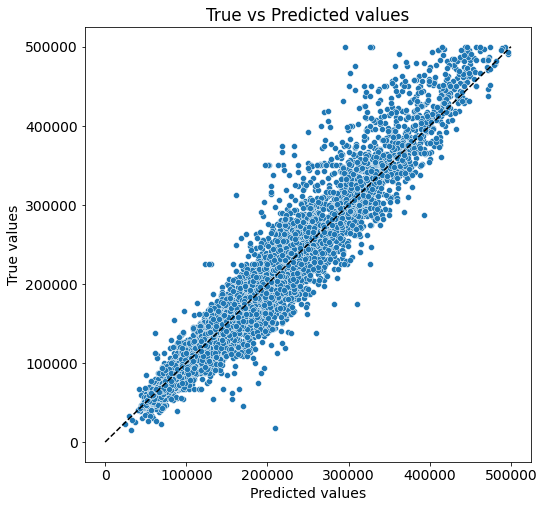

R2:	0.952
MAE:	15582.753
MSE:	495822619.216
RMSE:	22267.075


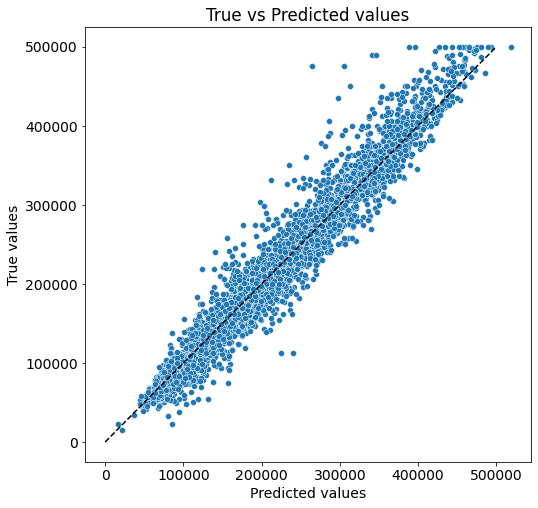

In [554]:
y_train_preds = final_model.predict(X_train)
evaluate_preds(y_train, y_train_preds)

y1_train_preds = final_model1.predict(X1_train)
evaluate_preds(y1_train, y1_train_preds)

y2_train_preds = final_model2.predict(X2_train)
evaluate_preds(y2_train, y2_train_preds)

R2:	0.818
MAE:	27808.653
MSE:	1755638121.164
RMSE:	41900.336


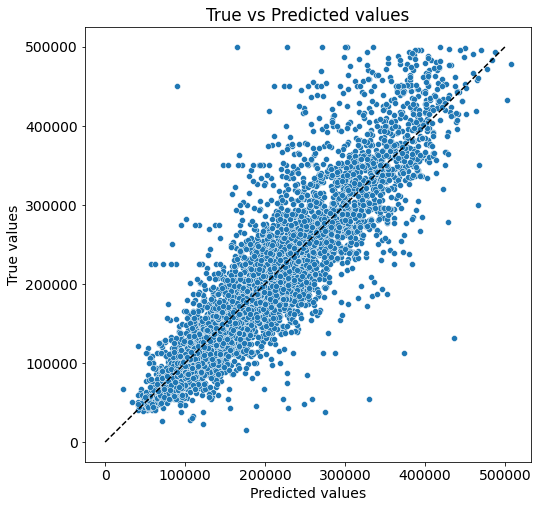

R2:	0.819
MAE:	26805.216
MSE:	1655310923.173
RMSE:	40685.512


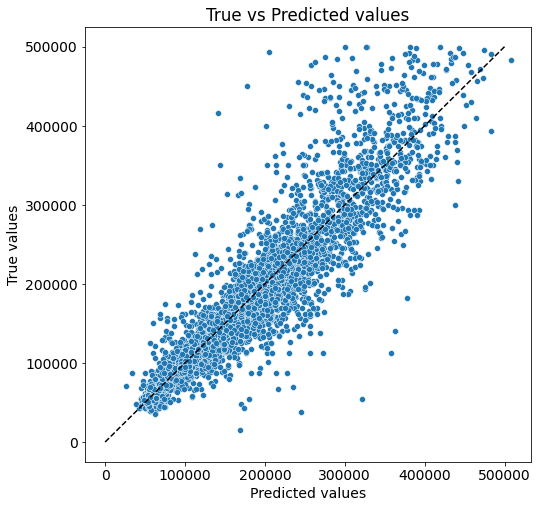

R2:	0.806
MAE:	29840.026
MSE:	1971128004.205
RMSE:	44397.387


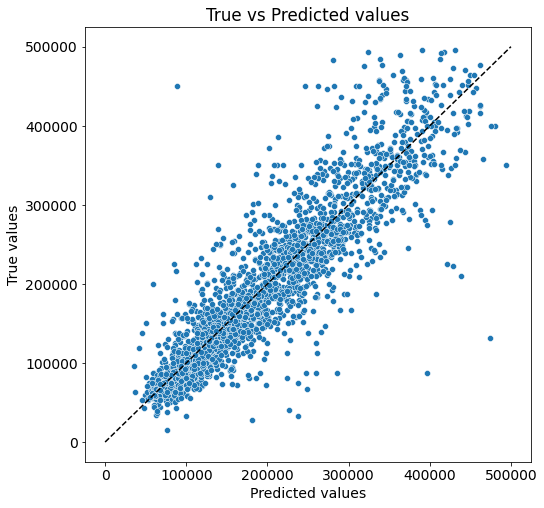

In [555]:
y_test_preds = final_model.predict(X_test)
evaluate_preds(y_test, y_test_preds)

y1_test_preds = final_model1.predict(X1_test)
evaluate_preds(y1_test, y1_test_preds)

y2_test_preds = final_model2.predict(X2_test)
evaluate_preds(y2_test, y2_test_preds)

Выводы:
1. Общая финальная модель работает лучше, чем модели для каждого района в отдельности.
2. В качестве итога можно взять результат общей финальной модели:

R2:	0.818

MAE:	27808.653

MSE:	1755638121.164

RMSE:	41900.336

3. Тюнинг модели проводился по трём параметрам. В итоге: 'max_depth': 5, 'min_samples_leaf': 8, 'n_estimators': 400.

**Важность признаков**

In [556]:
feature_importances = pd.DataFrame(zip(X_train.columns,
                                       final_model.feature_importances_),
                                   columns = ['feature_name', 'importance'])

feature_importances.sort_values(by = 'importance', ascending = False)

,feature_name,importance
3,median_income,0.443621
4,INLAND,0.170417
0,longitude,0.106753
1,latitude,0.099515
5,men_per_household,0.098811
6,population_per_room,0.041861
2,housing_median_age,0.039022


## **Сохранение модели**

In [557]:
with open(SCALER_FILE_PATH, 'wb') as file:
    pickle.dump(scaler, file)

In [558]:
with open(MODEL_FILE_PATH, 'wb') as file:
    pickle.dump(final_model, file)